# Mount Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Import Libraries

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from tqdm import tqdm
from PIL import Image
import torchvision.transforms as transforms
import torchvision.models as models

# Device Setup

In [ ]:
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(DEVICE)

cuda


# Import Images

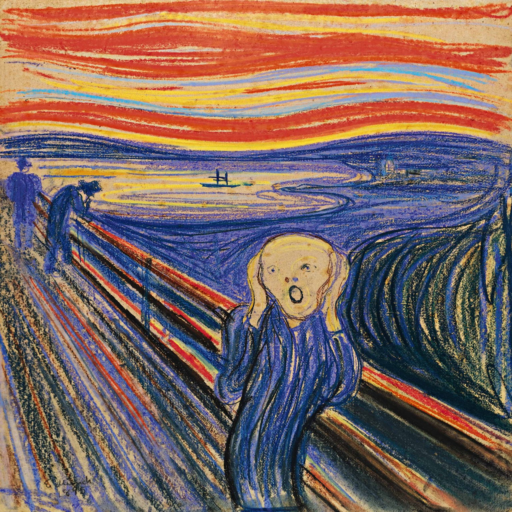

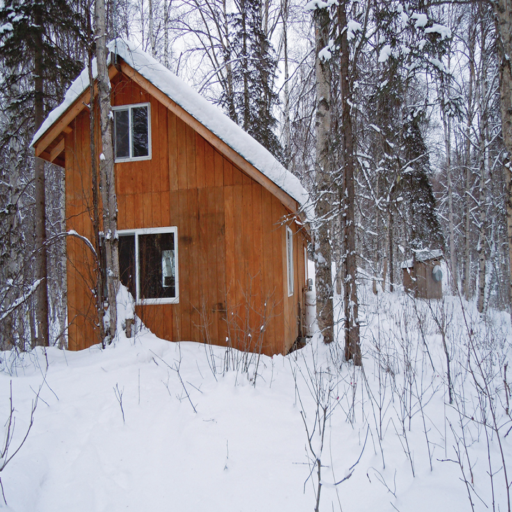

In [ ]:
# Image paths

# Van Gogh
# style_image_path = "/content/drive/MyDrive/pix/images/images/Vincent_van_Gogh/Vincent_van_Gogh_368.jpg"

# George Seurat
# style_image_path = "/content/drive/MyDrive/pix/images/images/Georges_Seurat/Georges_Seurat_23.jpg"

# Monet
# style_image_path = "/content/drive/MyDrive/pix/images/images/Claude_Monet/Claude_Monet_70.jpg"

# Picasso
# style_image_path = "/content/drive/MyDrive/pix/images/images/Pablo_Picasso/Pablo_Picasso_250.jpg" # 101

# Great Wave
# style_image_path = "/content/drive/MyDrive/GoogleImages/images/images/uploads/wave.jpg"

# Explosion
# style_image_path = "/content/drive/MyDrive/GoogleImages/images/images/uploads/explosion.jpg"

# Scream
style_image_path = "/content/drive/MyDrive/GoogleImages/images/images/uploads/the_scream.jpg"

# Seated Nude
# style_image_path = "/content/drive/MyDrive/GoogleImages/images/images/uploads/seated-nude.jpg"

# Plains
# style_image_path = "/content/drive/MyDrive/GoogleImages/images/images/uploads/plains.jpg"

# Sunset
# style_image_path = "/content/drive/MyDrive/GoogleImages/images/images/uploads/sunset.jpg"



# Forest and boardwalk
# content_image_path = "/content/drive/MyDrive/GoogleImages/images/images/travel/Places365_val_00005811.jpg"

# Indian uncle feast
# content_image_path = "/content/drive/MyDrive/GoogleImages/images/images/travel/Places365_val_00014468.jpg"

# Capitol building
# content_image_path = "/content/drive/MyDrive/GoogleImages/images/images/architecure/184082592_6da2f68a4c_n.jpg"

# Monument valley
# content_image_path = "/content/drive/MyDrive/GoogleImages/images/images/uploads/allen_stair.jpg"

# Mclaren 720s
# content_image_path = "/content/drive/MyDrive/GoogleImages/images/images/uploads/Mclaren_720s_crop.jpg"

# Artist Point Tree
# content_image_path = "/content/drive/MyDrive/GoogleImages/images/images/uploads/tree_reflect.jpg"

# Artist Point Mountain
# content_image_path = "/content/drive/MyDrive/GoogleImages/images/images/uploads/mtn_reflect.jpg"

# Waterfall
# content_image_path = "/content/drive/MyDrive/GoogleImages/images/images/uploads/waterfall.jpg"

# Paradise
# content_image_path = "/content/drive/MyDrive/GoogleImages/images/images/uploads/paradise.jpg"

# River
# content_image_path = "/content/drive/MyDrive/GoogleImages/images/images/uploads/river.jpg"

# Arnav
# content_image_path = "/content/drive/MyDrive/GoogleImages/images/images/uploads/arnav-pic.jpg"

# Nose Flute
# content_image_path = "/content/drive/MyDrive/GoogleImages/images/images/uploads/nose_flute.jpg"

# Lake with Tree
# content_image_path = "/content/drive/MyDrive/GoogleImages/images/images/uploads/lake_with_tree.jpg"

# White
content_image_path = "/content/drive/MyDrive/GoogleImages/images/images/uploads/Karens_christmas.jpg"



# Create image objects
style_image = Image.open(style_image_path)
content_image = Image.open(content_image_path)

# Image/Tensor processing functions
image_dimensions = (512, 512)  # Dimensions for vgg model
resize_image = transforms.Resize(image_dimensions)
image_to_tensor = transforms.PILToTensor()
tensor_to_image = transforms.ToPILImage()

# Resize images to same dimensions
resized_style_image = resize_image(style_image)
resized_content_image = resize_image(content_image)
display(resized_style_image)
display(resized_content_image)

# Convert images to tensors (Normalize RGB values from 0-255 to 0-1)
style_tensor = image_to_tensor(resized_style_image).unsqueeze(0) / 255  # unsqueeze to add an extra dimension so it can be passed into vgg
content_tensor = image_to_tensor(resized_content_image).unsqueeze(0) / 255  # unsqueeze to add an extra dimension so it can be passed into vgg
input_tensor = content_tensor.clone().float()

# Move tensors to GPU
style_tensor = style_tensor.to(DEVICE, torch.float)
content_tensor = content_tensor.to(DEVICE, torch.float)
input_tensor = input_tensor.to(DEVICE, torch.float)

#Unmount Google Drive

In [ ]:
# Remove Google Drive folder from Colab
drive.flush_and_unmount()

# Feature Extraction Model

In [ ]:
# Model to extract features
class model(nn.Module):
  def __init__(self):
    super().__init__()
    # The indices of the conv1_1, conv2_1, conv3_1, conv4_1, and conv5_1 layers
    self.layer_indices = [0, 5, 10, 23, 28]
    # First 29 layers of vgg19.features model
    self.vgg = models.vgg19(pretrained=True).features[:29]

  def forward(self, x):
    features = []
    for layer_index, layer in enumerate(self.vgg):
      # Forward Propogate
      x=layer(x)
      # Get features at requested layers
      if layer_index in self.layer_indices:
        features.append(x)
    return features

# Loss Functions

In [ ]:
# Get l1 loss between content features and generated features
def content_loss(content_features, generated_features):
  return F.l1_loss(content_features, generated_features)

# Get l1 loss between gram matrices of style features and generated features
def style_loss(style_features, generated_features):
  batches, channels, rows, columns = generated_features.shape

  # Calculate gram matrices
  style_gram_matrix = style_features.view(channels, rows * columns) @ style_features.view(channels, rows * columns).T
  generated_gram_matrix = generated_features.view(channels, rows * columns) @ generated_features.view(channels, rows * columns).T
  # Normalize gram matrices
  style_gram_matrix /= batches * channels * rows * columns
  generated_gram_matrix /= batches * channels * rows * columns

  # Return L1 Loss between gram matrices
  return F.l1_loss(style_gram_matrix, generated_gram_matrix)

# alpha is the weight of the content loss in the total loss
# beta is the weight of the style loss in the total loss
def total_loss(content_features_list, style_features_list, generated_features_list, alpha=0.5, beta=0.5):
  total_content_loss, total_style_loss = 0, 0
  # Get the loss for all features
  for content_features, style_features, generated_features in zip(content_features_list, style_features_list, generated_features_list):
    total_content_loss += content_loss(content_features, generated_features)
    total_style_loss += style_loss(style_features, generated_features)
  return alpha * total_content_loss + beta * total_style_loss
  


# Style Transfer

In [ ]:
def style_transfer(content_tensor, style_tensor, generated_tensor, model, epochs, lr, alpha, beta):
  generated_tensor.requires_grad_(True)
  model.requires_grad_(False)

  optimizer = optim.Adam(params=[generated_tensor], lr=lr)

  for epoch in tqdm(range(epochs), leave='false'):
    optimizer.zero_grad()
    content_features_list = model(content_tensor)
    style_features_list = model(style_tensor)
    generated_features_list = model(generated_tensor)
    loss = total_loss(content_features_list, style_features_list, generated_features_list, alpha, beta)
    loss.backward()
    optimizer.step()

    # Display generated image every 100 epochs
    if (epoch + 1) % 100 == 0:
      generated_image = tensor_to_image(torch.clamp(generated_tensor.clone().detach(), 0, 1).squeeze(0))
      display(generated_image)

  return torch.clamp(generated_tensor, 0, 1)



# Main

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth


  0%|          | 0.00/548M [00:00<?, ?B/s]

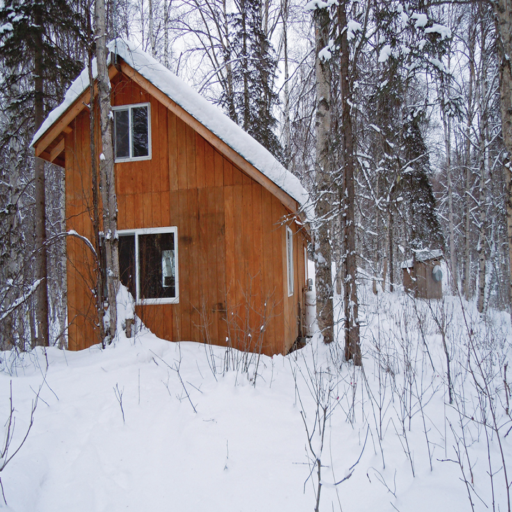

  2%|▏         | 99/5000 [00:15<13:03,  6.26it/s]

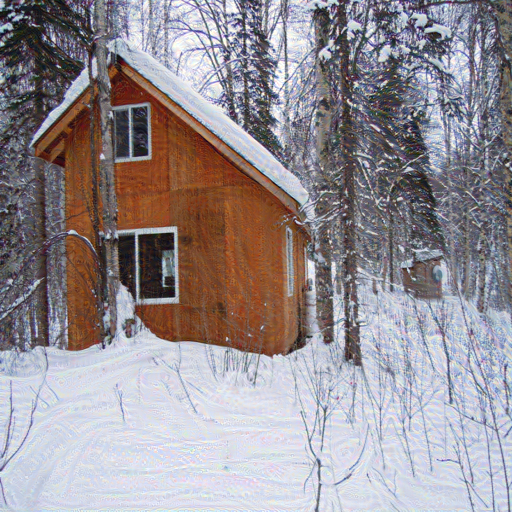

  4%|▍         | 199/5000 [00:31<13:00,  6.15it/s]

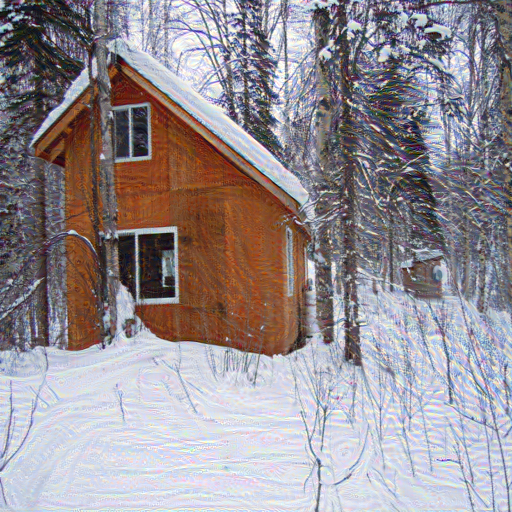

  6%|▌         | 299/5000 [00:48<13:01,  6.02it/s]

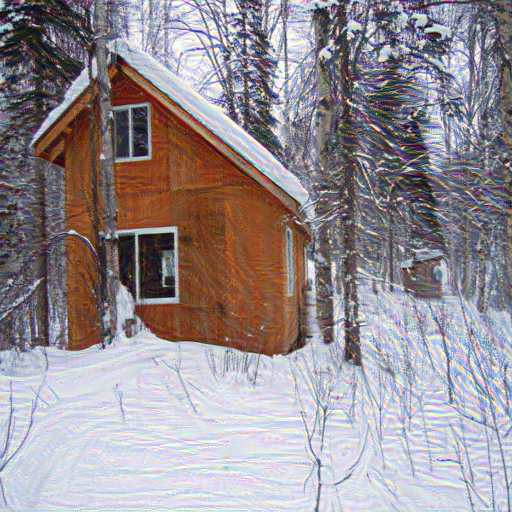

  8%|▊         | 399/5000 [01:05<13:00,  5.90it/s]

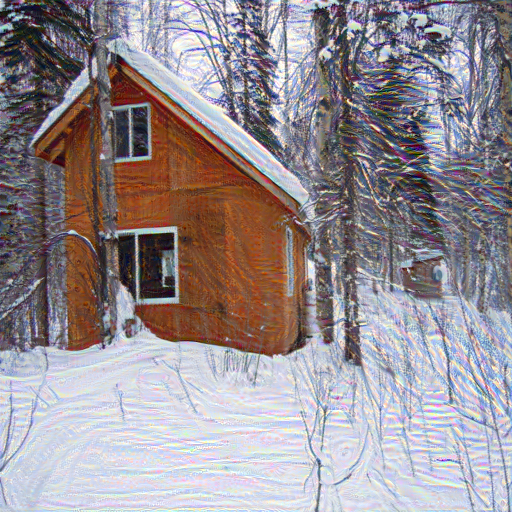

 10%|▉         | 499/5000 [01:22<12:58,  5.78it/s]

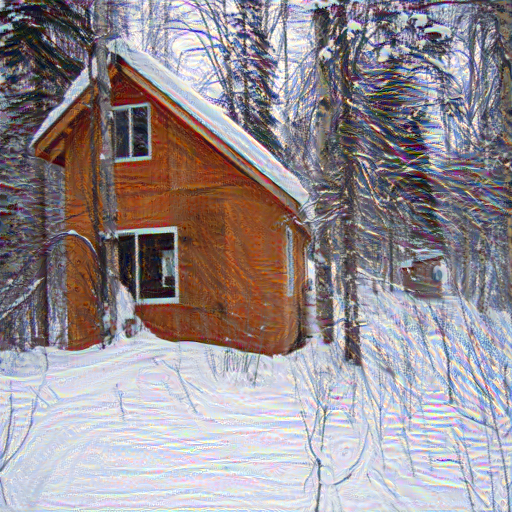

 12%|█▏        | 599/5000 [01:39<12:46,  5.74it/s]

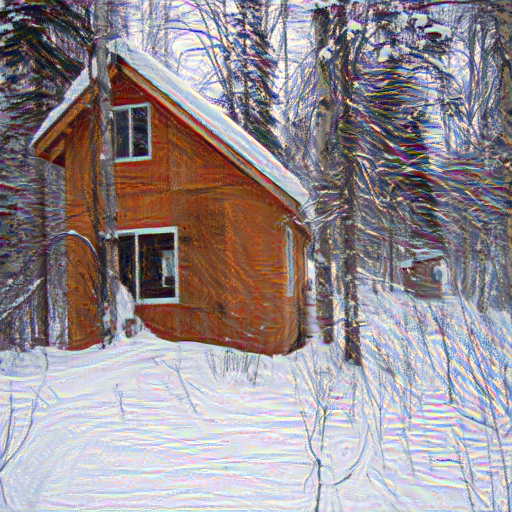

 14%|█▍        | 699/5000 [01:57<12:17,  5.83it/s]

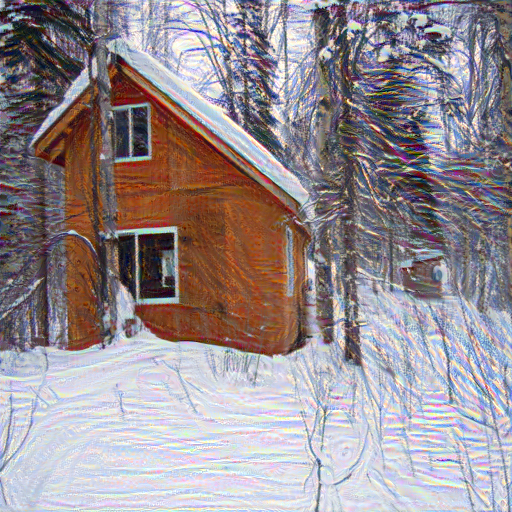

 16%|█▌        | 799/5000 [02:14<11:56,  5.86it/s]

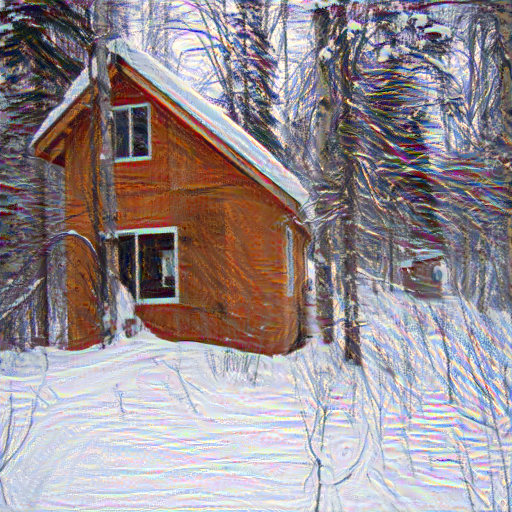

 18%|█▊        | 899/5000 [02:31<11:39,  5.86it/s]

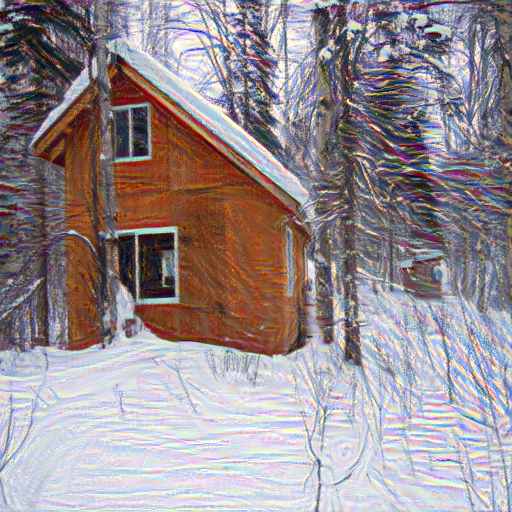

 20%|█▉        | 999/5000 [02:48<11:24,  5.84it/s]

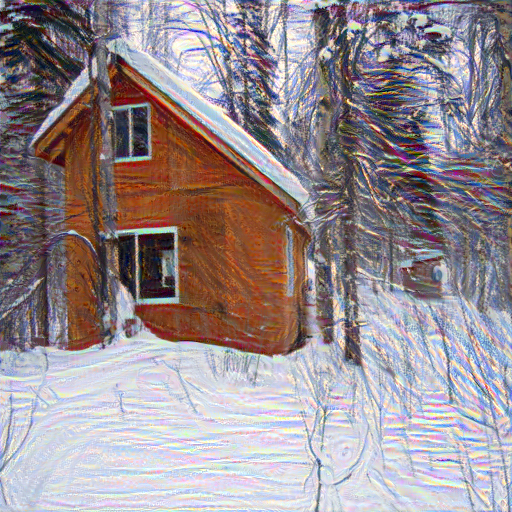

 22%|██▏       | 1099/5000 [03:05<11:11,  5.81it/s]

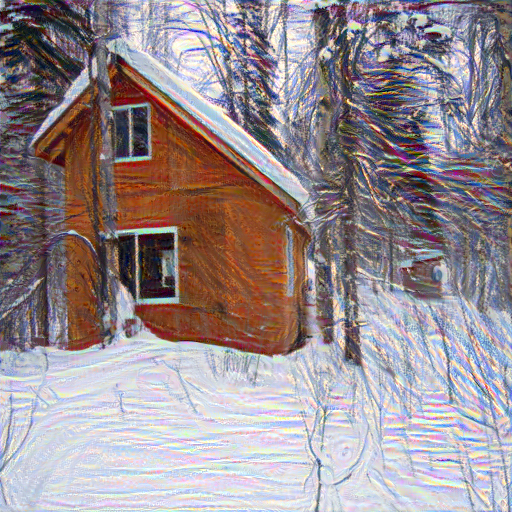

 24%|██▍       | 1199/5000 [03:23<10:54,  5.81it/s]

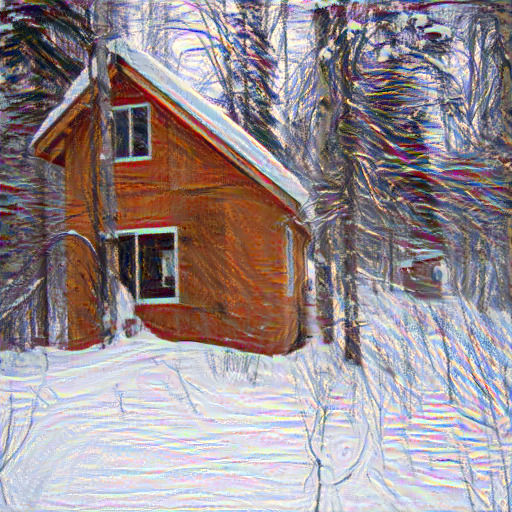

 26%|██▌       | 1299/5000 [03:40<10:33,  5.84it/s]

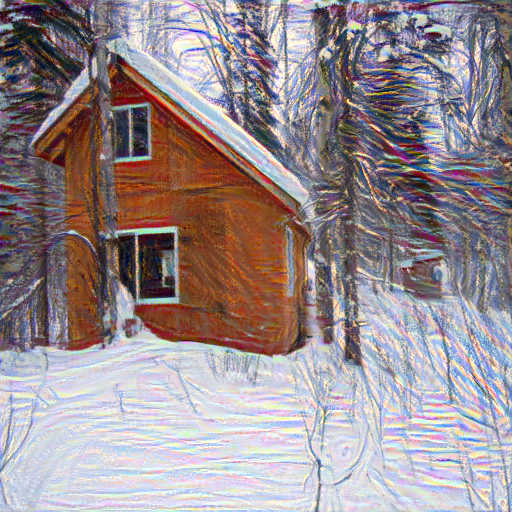

 28%|██▊       | 1399/5000 [03:57<10:17,  5.83it/s]

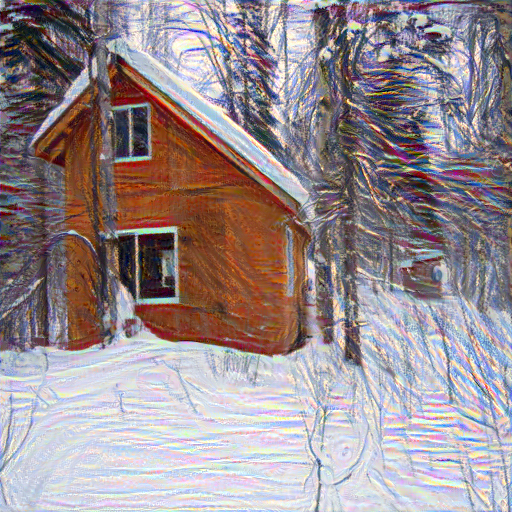

 30%|██▉       | 1499/5000 [04:14<09:57,  5.86it/s]

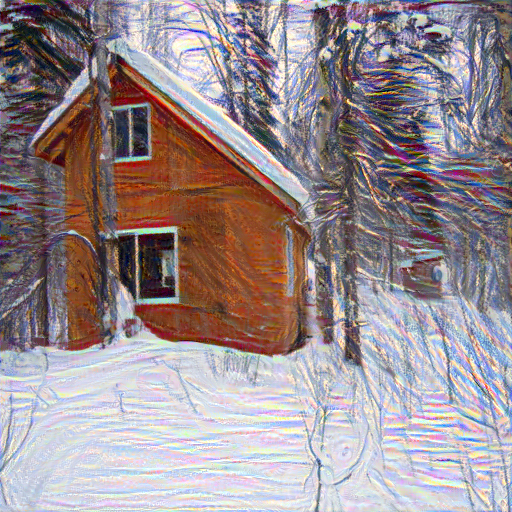

 32%|███▏      | 1599/5000 [04:31<09:42,  5.84it/s]

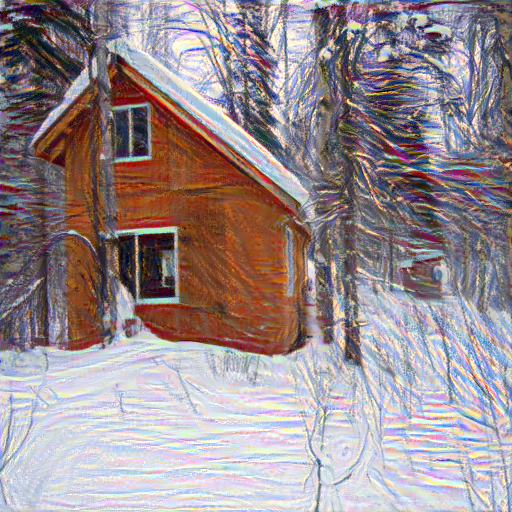

 34%|███▍      | 1699/5000 [04:49<09:24,  5.84it/s]

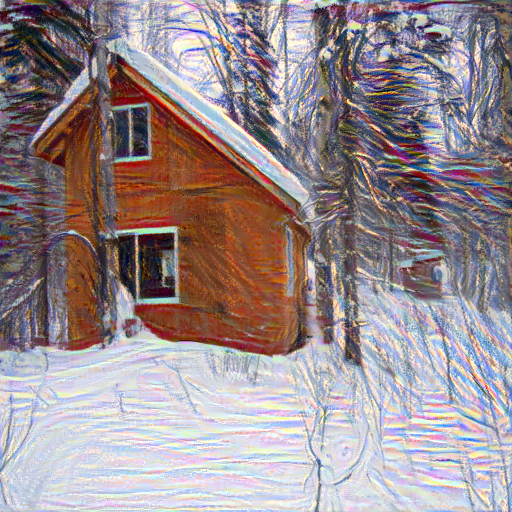

 36%|███▌      | 1799/5000 [05:06<09:07,  5.84it/s]

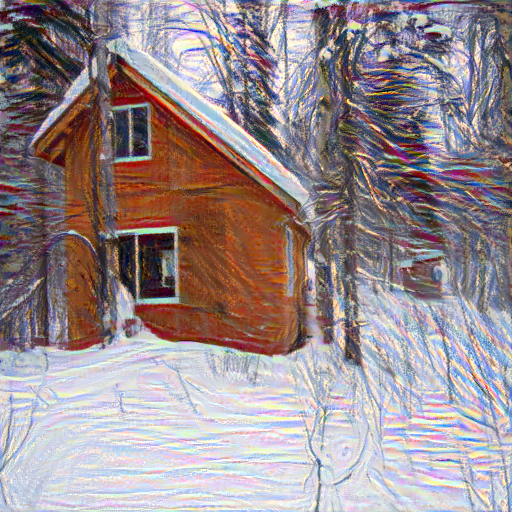

 38%|███▊      | 1899/5000 [05:23<08:51,  5.83it/s]

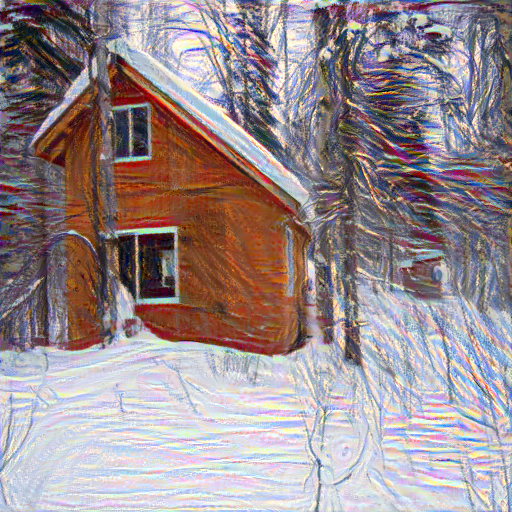

 40%|███▉      | 1999/5000 [05:40<08:35,  5.82it/s]

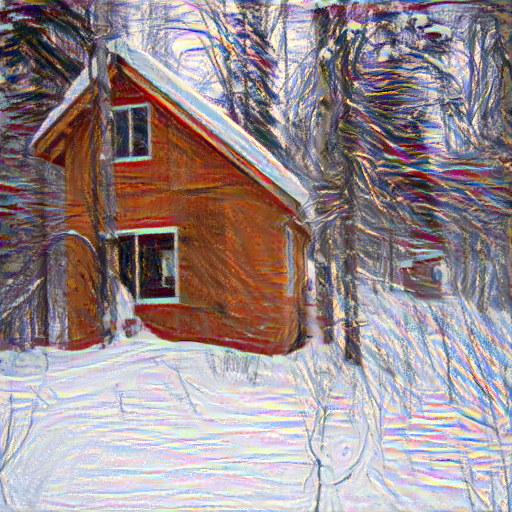

 42%|████▏     | 2099/5000 [05:58<08:19,  5.81it/s]

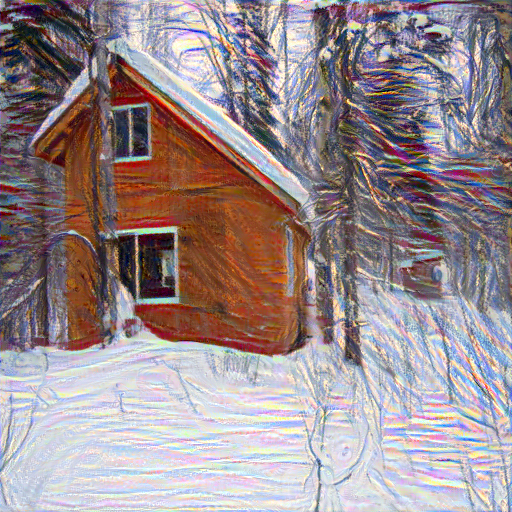

 44%|████▍     | 2199/5000 [06:15<08:01,  5.82it/s]

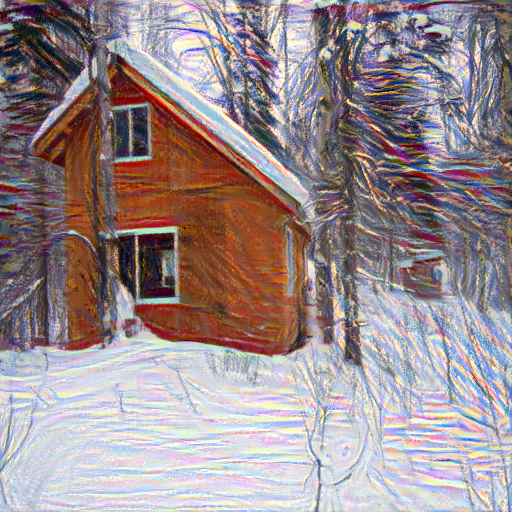

 46%|████▌     | 2299/5000 [06:32<07:43,  5.82it/s]

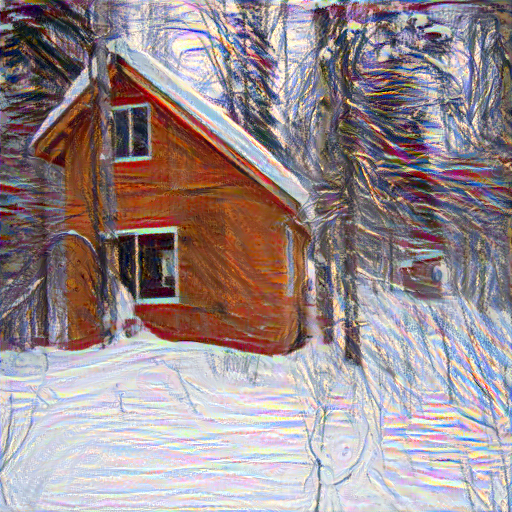

 48%|████▊     | 2399/5000 [06:49<07:27,  5.82it/s]

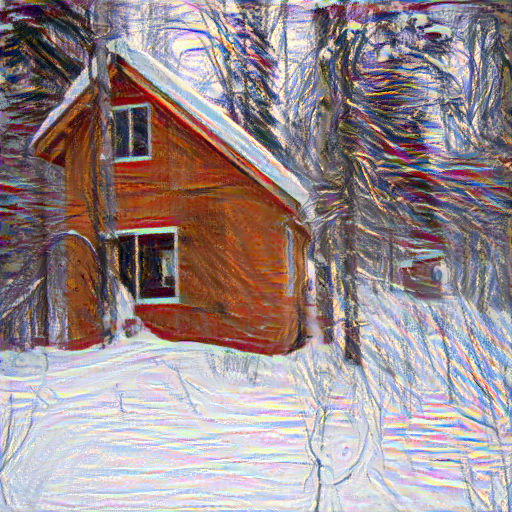

 50%|████▉     | 2499/5000 [07:07<07:09,  5.83it/s]

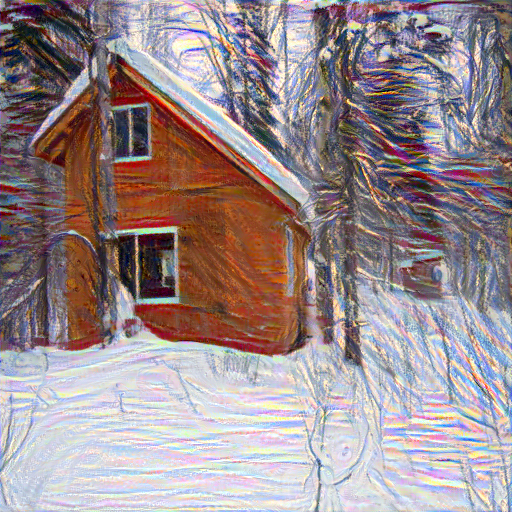

 52%|█████▏    | 2599/5000 [07:24<06:52,  5.83it/s]

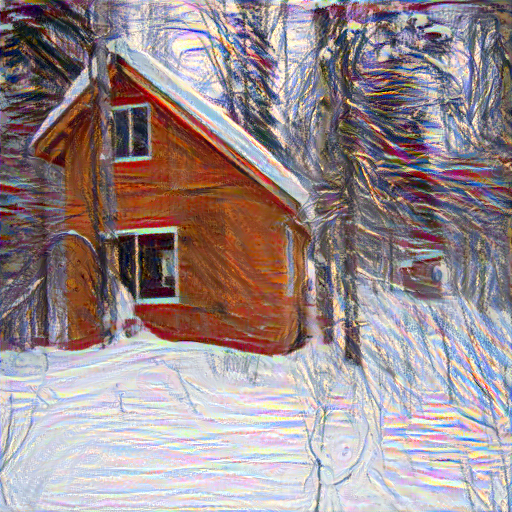

 54%|█████▍    | 2699/5000 [07:41<06:34,  5.83it/s]

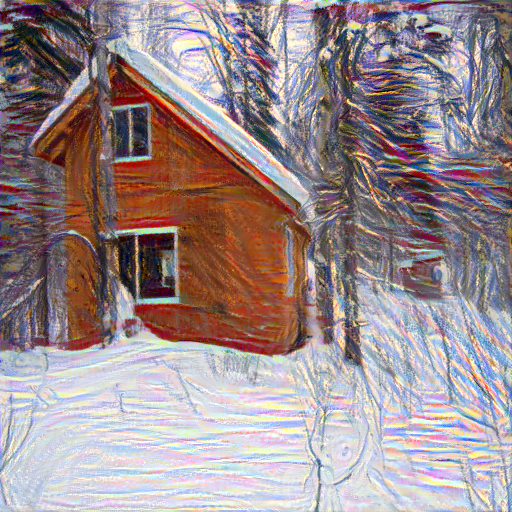

 56%|█████▌    | 2799/5000 [07:59<06:18,  5.82it/s]

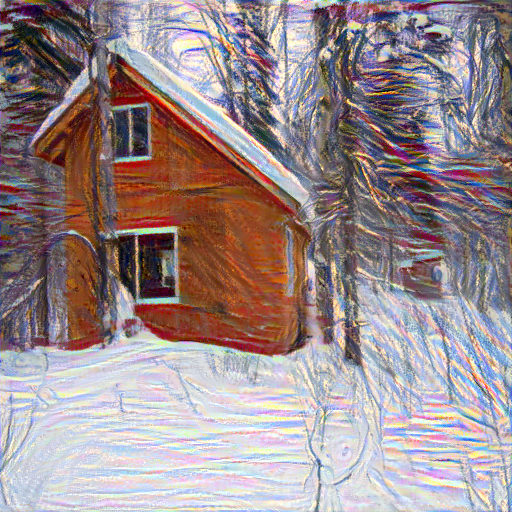

 58%|█████▊    | 2899/5000 [08:16<06:00,  5.83it/s]

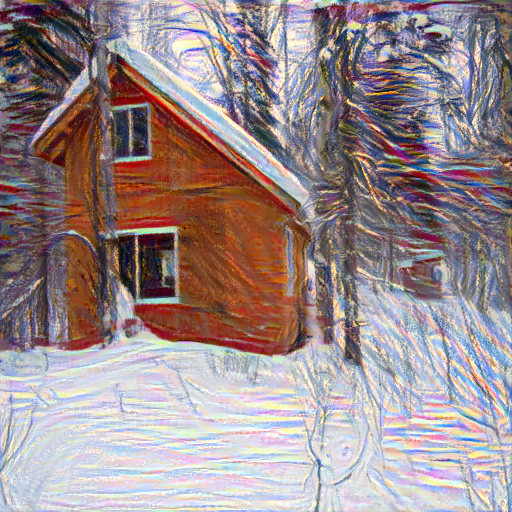

 60%|█████▉    | 2999/5000 [08:33<05:42,  5.84it/s]

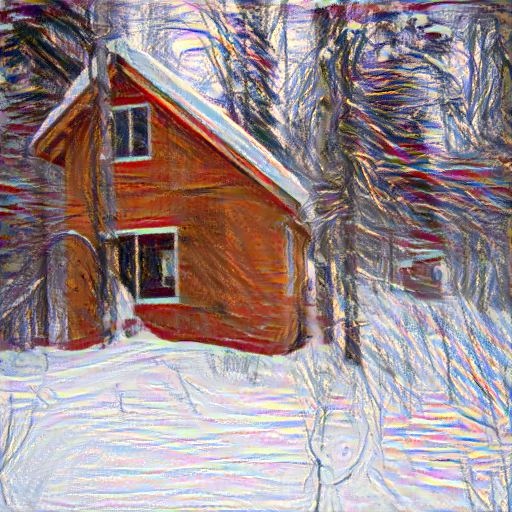

 62%|██████▏   | 3099/5000 [08:50<05:24,  5.85it/s]

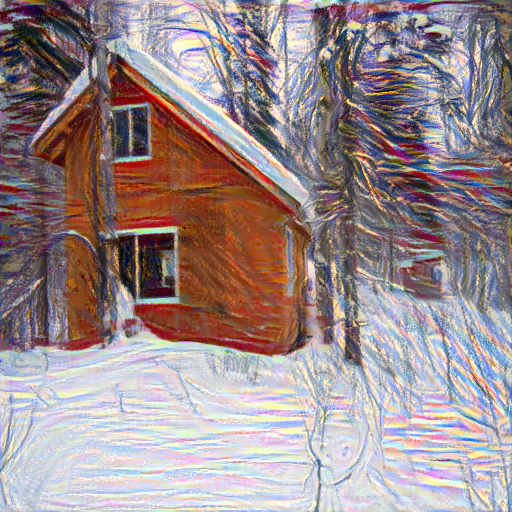

 64%|██████▍   | 3199/5000 [09:08<05:08,  5.84it/s]

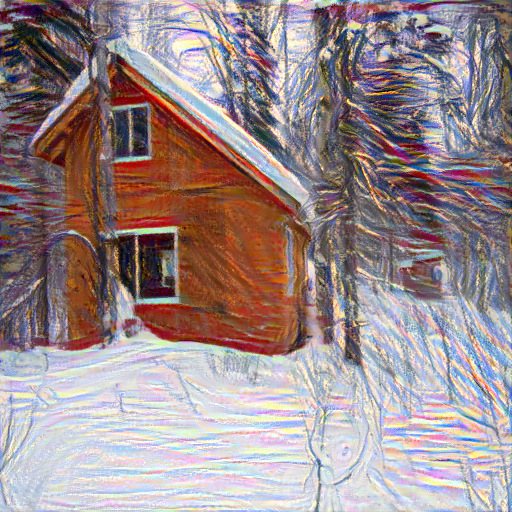

 66%|██████▌   | 3299/5000 [09:25<04:51,  5.84it/s]

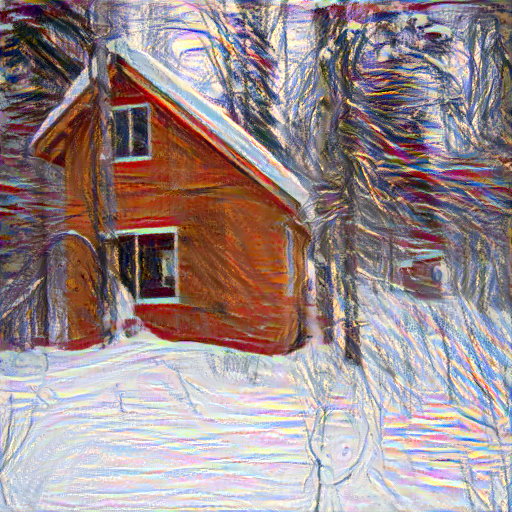

 68%|██████▊   | 3399/5000 [09:42<04:34,  5.82it/s]

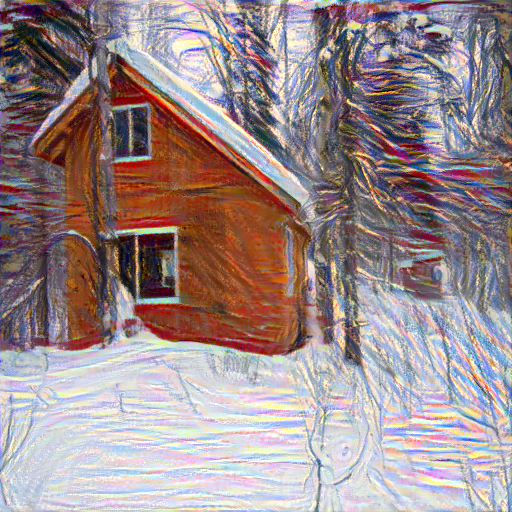

 70%|██████▉   | 3499/5000 [09:59<04:16,  5.84it/s]

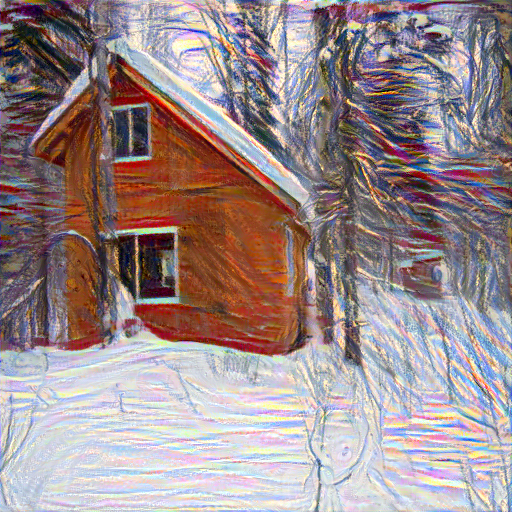

 72%|███████▏  | 3599/5000 [10:16<03:59,  5.84it/s]

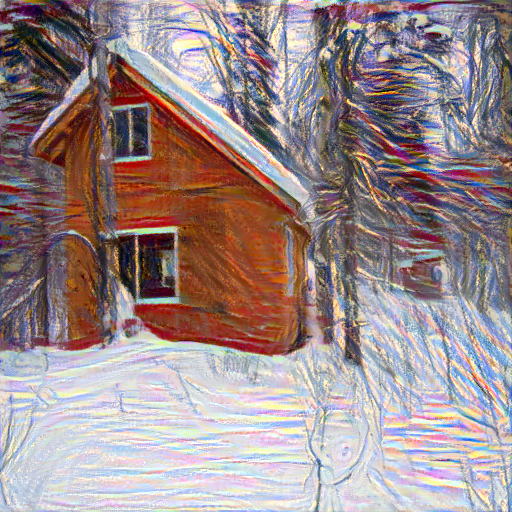

 74%|███████▍  | 3699/5000 [10:34<03:42,  5.85it/s]

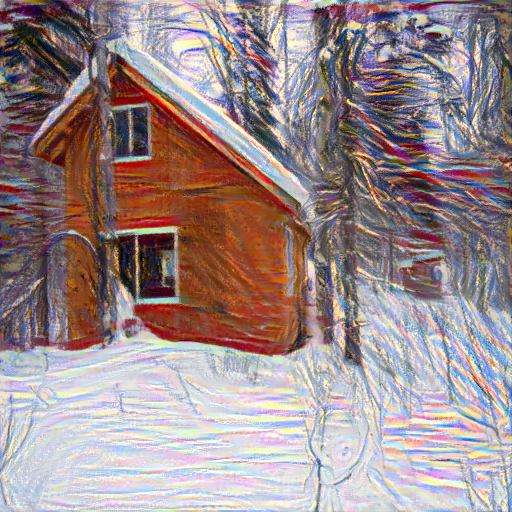

 76%|███████▌  | 3799/5000 [10:51<03:25,  5.83it/s]

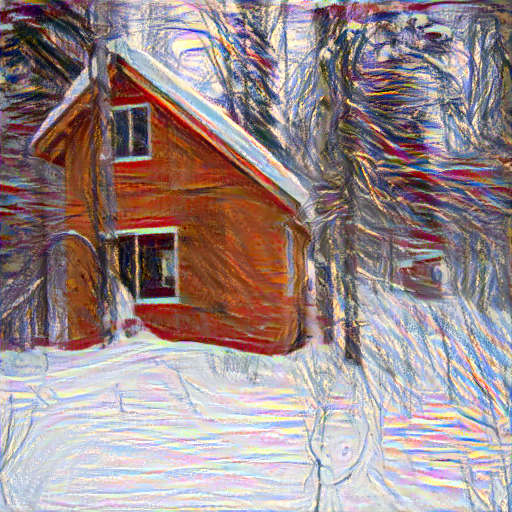

 78%|███████▊  | 3899/5000 [11:08<03:08,  5.83it/s]

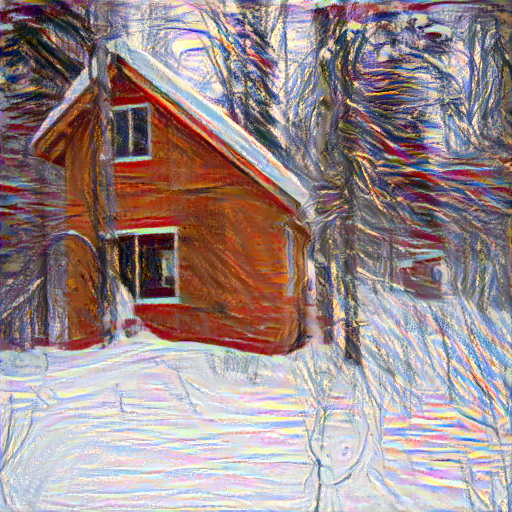

 80%|███████▉  | 3999/5000 [11:25<02:51,  5.83it/s]

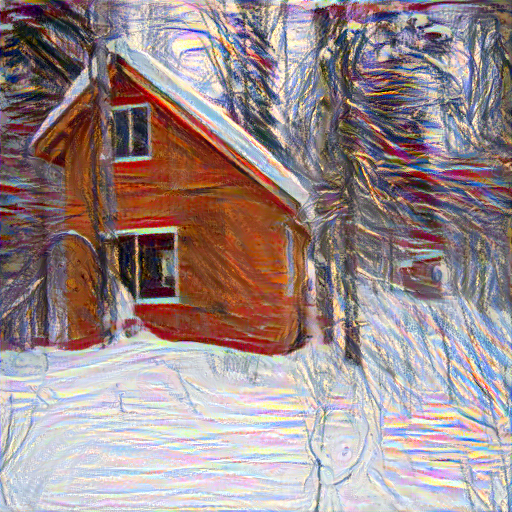

 82%|████████▏ | 4099/5000 [11:43<02:34,  5.82it/s]

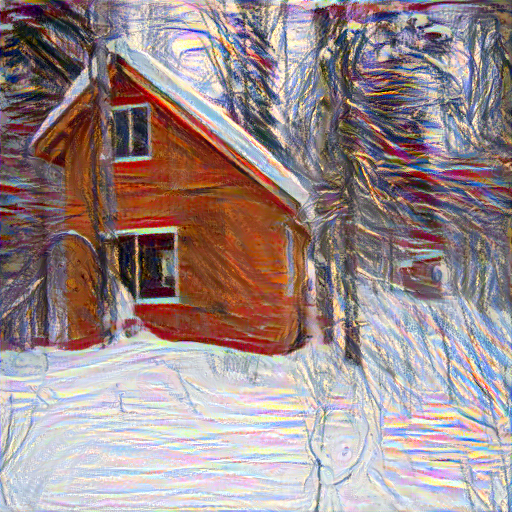

 84%|████████▍ | 4199/5000 [12:00<02:17,  5.82it/s]

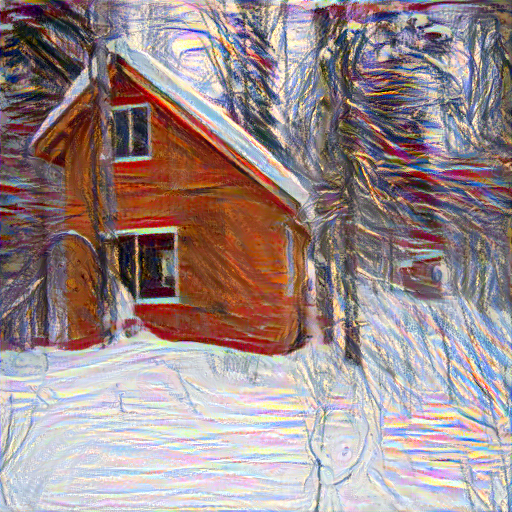

 86%|████████▌ | 4299/5000 [12:17<02:00,  5.83it/s]

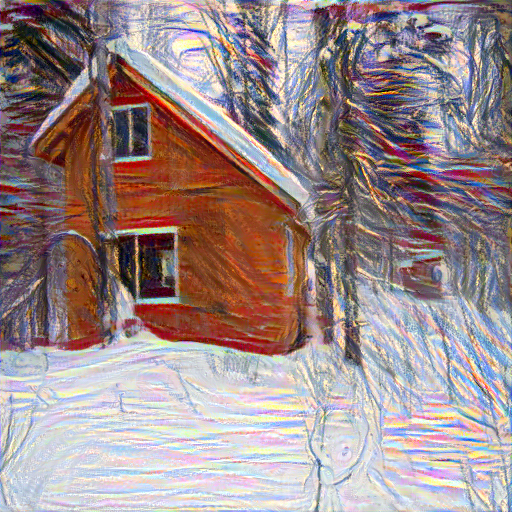

 88%|████████▊ | 4399/5000 [12:35<01:43,  5.83it/s]

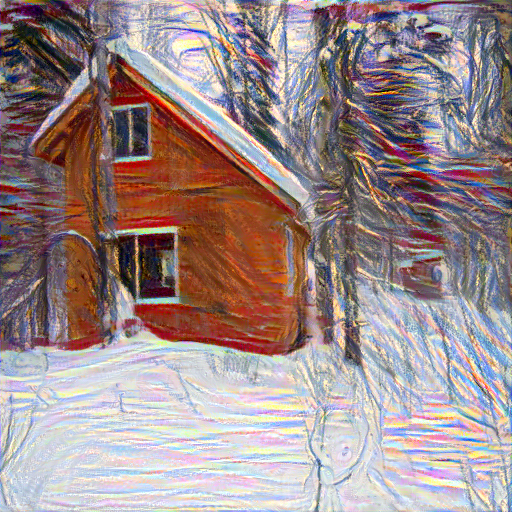

 90%|████████▉ | 4499/5000 [12:52<01:25,  5.84it/s]

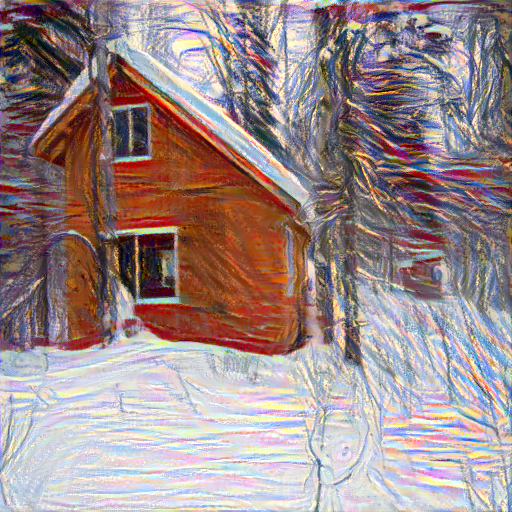

 92%|█████████▏| 4599/5000 [13:09<01:08,  5.83it/s]

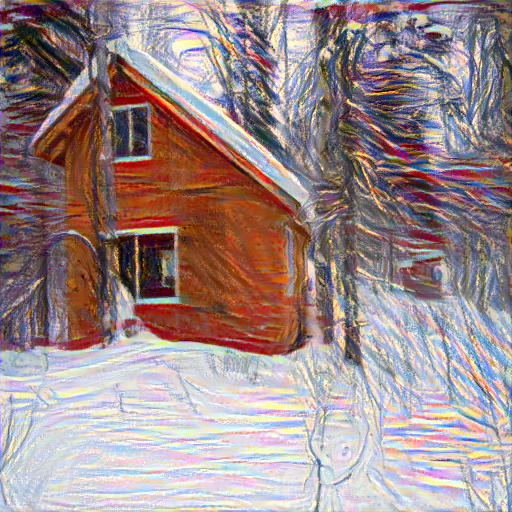

 94%|█████████▍| 4699/5000 [13:26<00:51,  5.82it/s]

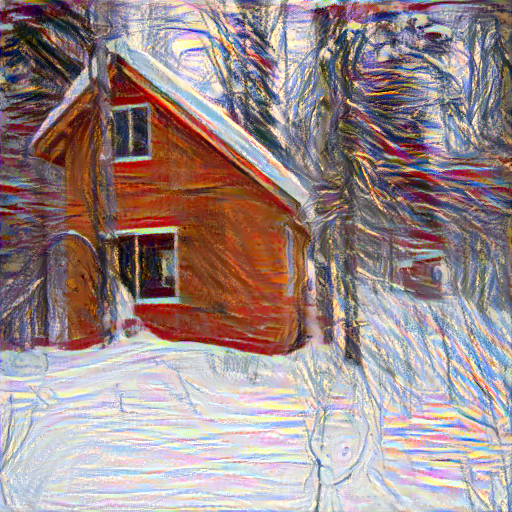

 96%|█████████▌| 4799/5000 [13:44<00:34,  5.82it/s]

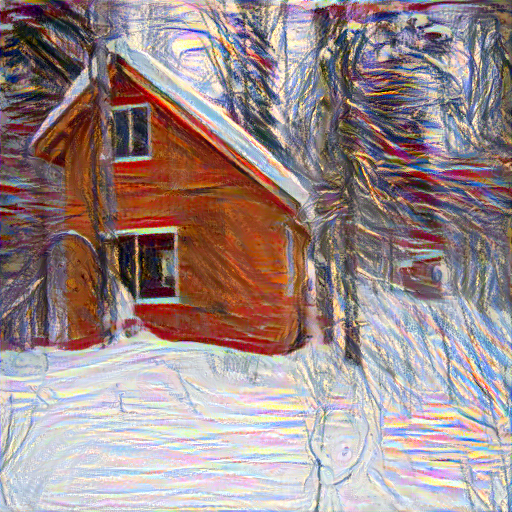

 98%|█████████▊| 4899/5000 [14:01<00:17,  5.82it/s]

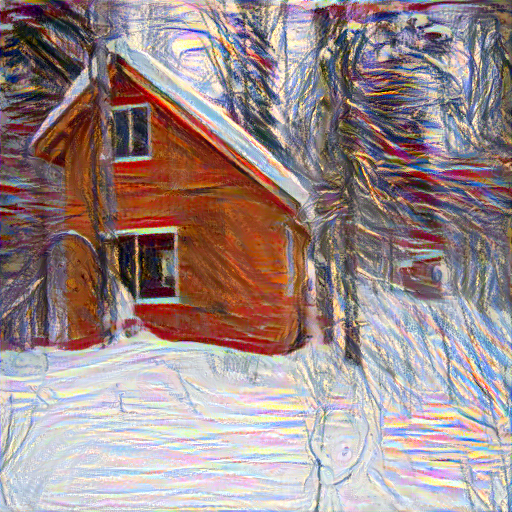

100%|█████████▉| 4999/5000 [14:18<00:00,  5.82it/s]

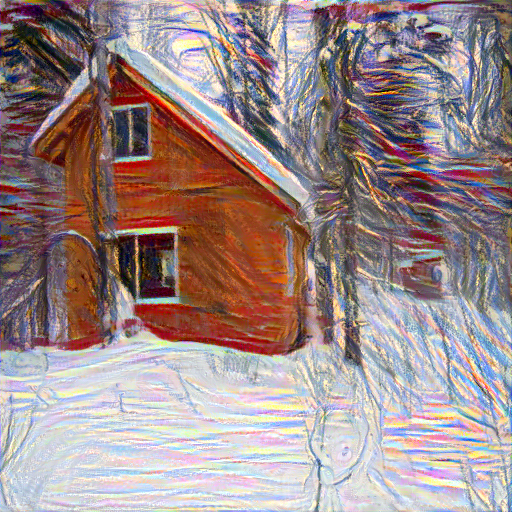

100%|██████████| 5000/5000 [14:19<00:00,  5.82it/s]


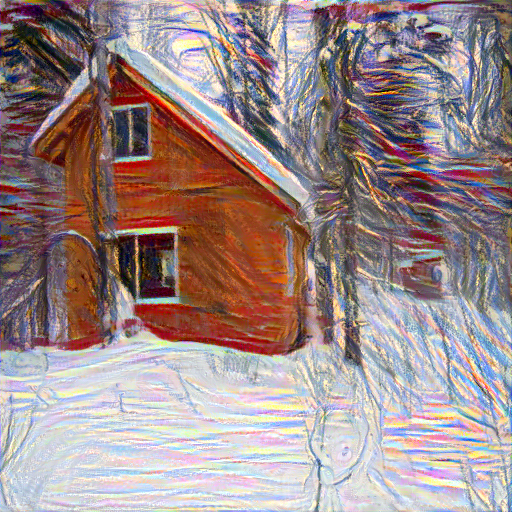

In [ ]:
# Feature Extraction Model
feature_extractor = model().to(DEVICE).eval()

# Hyperparameters
epochs = 5000
lr = 0.001
alpha = 1  # Content Weight
beta = 1e9  # Style Weight

# Display input image
input_image = tensor_to_image(input_tensor.clone().squeeze(0))
display(input_image)

# Perform style transfer and display final generated image
final_tensor = style_transfer(content_tensor.clone(), style_tensor.clone(), input_tensor.clone(), feature_extractor, epochs, lr, alpha, beta)
final_image = tensor_to_image(final_tensor.clone().squeeze(0))
display(final_image)


# Display Style, Initial, and Final Image

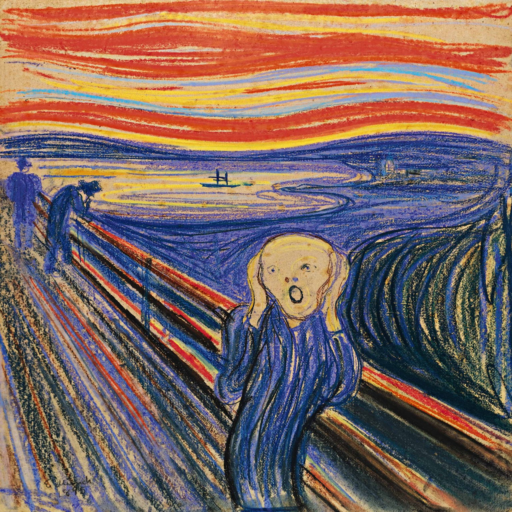

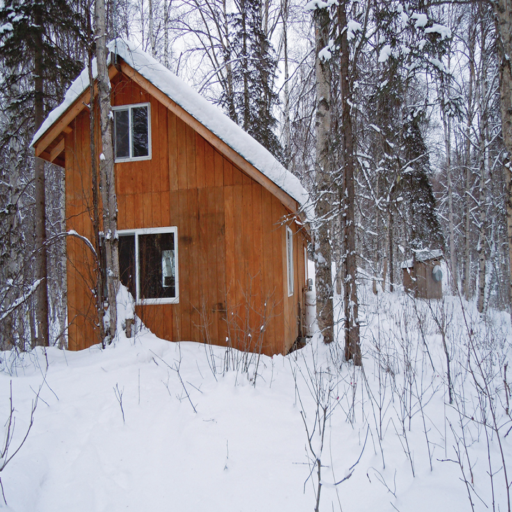

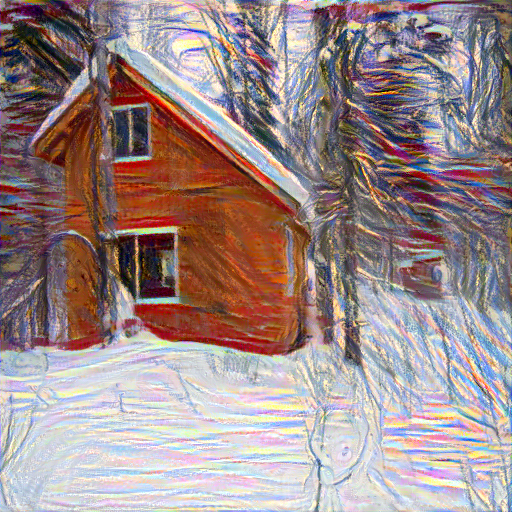

In [ ]:
display(resized_style_image)
display(input_image)
display(final_image)